# Module 3: Machine Learning

## Sprint 4: Machine Learning capstone project

## Kaggle competition with a complex dataset

## Background

---

Participating in Kaggle competitions is an efficient way to learn some aspects of Machine Learning. You can read solutions made public by the others, participate in the discussions to talk about solution ideas and test them by submitting them for evaluation.

The metric used for evaluation can vary from competition to competition, but the idea remains the same - build a model that is as accurate as possible on the testing set. In industry, there are other factors to consider when building machine learning models - inference time, solution complexity, maintainability and so on. However, even though you only learn a subset of the required skills while participating in Kaggle competitions, it is quite a fun way to learn by doing it, so let's participate in one of the competitions again! This time, a competition having a really complex dataset.

## The competition

Pick and participate in one of the following Kaggle competitions, where they all have complex datasets, which creates a lot of space for creative feature engineering and model building:

- https://www.kaggle.com/c/petfinder-adoption-prediction/overview
- https://www.kaggle.com/c/avito-demand-prediction/overview
- https://www.kaggle.com/c/home-credit-default-risk/overview

For help, you can look at some of the notebooks by other competitors. However, try to write code by yourself, as even though you will always be able to consult external resources while working as a professional, the main thing right now to is learn, not to get a good score in the leaderboard.

---

## Requirements

- Data exploration
- Feature engineering
- At least several different models built and compared to each other on the validation set and on the public and private leaderboards
- Clean code
- At least median private leaderboard score (0.786)

## Evaluation criteria

- Private leaderboard score
- How simple is the model
- How fast is the model prediction
- Code quality

# Competition code

In [1]:
# Import the modules

import pandas as pd
import numpy as np

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

import xgboost as xgb
import lightgbm as lgb

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
pio.renderers.default = "colab"
pio.templates.default = "plotly_dark"

from plotly import tools
from plotly.subplots import make_subplots

import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use("seaborn-whitegrid")

from datetime import datetime

RANDOM_STATE = 1
DATA_PATH = "~/Google Drive/Learning/Data/341_home_credit_default_risk/"

import warnings
warnings.filterwarnings("ignore")

In [2]:
### Options
# Show all columns
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

# Show human readabale number formatting instead of scientific
pd.set_option('display.float_format', lambda x: '%.2f' % x)

In [3]:
# Import the data
app_train_df = pd.read_csv(DATA_PATH + "application_train.csv")
app_test_df = pd.read_csv(DATA_PATH + "application_test.csv")
bureau_df = pd.read_csv(DATA_PATH + "bureau.csv")
bureau_balance_df = pd.read_csv(DATA_PATH + "bureau_balance.csv")
pos_cash_balance_df = pd.read_csv(DATA_PATH + "POS_CASH_balance.csv")
previous_app_df = pd.read_csv(DATA_PATH + "previous_application.csv")
installments_payments_df = pd.read_csv(DATA_PATH + "installments_payments.csv")
cc_balance_df = pd.read_csv(DATA_PATH + "credit_card_balance.csv")

In [4]:
# Plotting functions


In [108]:
# Create a dataframe with missing values
def get_missing_values(df: pd.DataFrame) -> pd.DataFrame:
  missing_values = pd.DataFrame()
  missing_values["counts"] = df.isnull().sum().sort_values(ascending=False)
  missing_values["percent"] = missing_values["counts"] / df.shape[0] * 100
  return missing_values[missing_values["counts"] > 0]

# Plot the missing values
def plot_missing_values(df: pd.DataFrame) -> None:
  fig = px.bar(df, x=df.index, y=df["percent"], title="Missing values")
  fig.show()

In [98]:
# Prepare submission function
def generateSubmissionCsv(predictions: pd.DataFrame, title: str) -> None:
  """
  Generates submission csv file and saves to desktop
  """
  submission = pd.read_csv(DATA_PATH + "sample_submission.csv")
  submission.iloc[:,1] = predictions
  now = datetime.now()
  timestamp = now.strftime("%Y-%m-%d_%H-%M-%S")
  submission.to_csv(f"~/Desktop/{title}_submission_{timestamp}.csv", index=False)

## EDA

In [6]:
# Check the sizes of all datasets
print(f"app_train shape {app_train_df.shape}")
print(f"app_test shape {app_test_df.shape}")
print(f"bureau shape {bureau_df.shape}")
print(f"bureau_balance shape {bureau_balance_df.shape}")
print(f"pos_cash_balance shape {pos_cash_balance_df.shape}")
print(f"previous_app shape {previous_app_df.shape}")
print(f"installments shape {installments_payments_df.shape}")
print(f"credit_card_balance shape {cc_balance_df.shape}")

app_train shape (307511, 122)
app_test shape (48744, 121)
bureau shape (1716428, 17)
bureau_balance shape (27299925, 3)
pos_cash_balance shape (10001358, 8)
previous_app shape (1670214, 37)
installments shape (13605401, 8)
credit_card_balance shape (3840312, 23)


### Preview datasets

#### Applications

We have quite a few datasets so let's start exploring them one by one. I'll start with the Application data. \
This dataset provides the information about loan and loan applicant at application time.

In [7]:
# Preview application_train
app_train_df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.00,406597.50,24700.50,351000.00,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.02,-9461,-637,-3648.00,-2120,NaN,1,1,0,1,1,0,Laborers,1.00,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.08,0.26,0.14,0.02,0.04,0.97,0.62,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,0.03,0.04,0.97,0.63,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,0.03,0.04,0.97,0.62,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,reg oper account,block of flats,0.01,"Stone, brick",No,2.00,2.00,2.00,2.00,-1134.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,1.00
1,100003,0,Cash loans,F,N,N,0,270000.00,1293502.50,35698.50,1129500.00,Family,State servant,Higher education,Married,House / apartment,0.00,-16765,-1188,-1186.00,-291,NaN,1,1,0,1,1,0,Core staff,2.00,1,1,MONDAY,11,0,0,0,0,0,0,School,0.31,0.62,NaN,0.10,0.05,0.99,0.80,0.06,0.08,0.03,0.29,0.33,0.01,0.08,0.05,0.00,0.01,0.09,0.05,0.99,0.80,0.05,0.08,0.03,0.29,0.33,0.01,0.08,0.06,0.00,0.00,0.10,0.05,0.99,0.80,0.06,0.08,0.03,0.29,0.33,0.01,0.08,0.06,0.00,0.01,reg oper account,block of flats,0.07,Block,No,1.00,0.00,1.00,0.00,-828.00,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.00,0.00,0.00,0.00
2,100004,0,Revolving loans,M,Y,Y,0,67500.00,135000.00,6750.00,135000.00,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.01,-19046,-225,-4260.00,-2531,26.00,1,1,1,1,1,0,Laborers,1.00,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.56,0.73,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,0.00,-815.00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.00,0.00,0.0

In [8]:
# Preview basic statistical info
app_train_df.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.00,307511.00,307511.00,307511.00,307511.00,307499.00,307233.00,307511.00,307511.00,307511.00,307511.00,307511.00,104582.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307509.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,134133.00,306851.00,246546.00,151450.00,127568.00,157504.00,103023.00,92646.00,143620.00,152683.00,154491.00,98869.00,124921.00,97312.00,153161.00,93997.00,137829.00,151450.00,127568.00,157504.00,103023.00,92646.00,143620.00,152683.00,154491.00,98869.00,124921.00,97312.00,153161.00,93997.00,137829.00,151450.00,127568.00,157504.00,103023.00,92646.00,143620.00,152683.00,154491.00,98869.00,124921.00,97312.00,153161.00,93997.00,137829.00,159080.00,306490.00,306490.00,306490.00,306490.00,307510.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,307511.00,265992.00,265992.00,265992.00,265992.00,265992.00,265992.00
mean,278180.52,0.08,0.42,168797.92,599026.00,27108.57,538396.21,0.02,-16037.00,63815.05,-4986.12,-2994.20,12.06,1.00,0.82,0.20,1.00,0.28,0.06,2.15,2.05,2.03,12.06,0.02,0.05,0.04,0.08,0.23,0.18,0.50,0.51,0.51,0.12,0.09,0.98,0.75,0.04,0.08,0.15,0.23,0.23,0.07,0.10,0.11,0.01,0.03,0.11,0.09,0.98,0.76,0.04,0.07,0.15,0.22,0.23,0.06,0.11,0.11,0.01,0.03,0.12,0.09,0.98,0.76,0.04,0.08,0.15,0.23,0.23,0.07,0.10,0.11,0.01,0.03,0.10,1.42,0.14,1.41,0.10,-962.86,0.00,0.71,0.00,0.02,0.09,0.00,0.08,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.01,0.00,0.01,0.00,0.00,0.00,0.01,0.01,0.03,0.27,0.27,1.90
std,102790.18,0.27,0.72,237123.15,402490.78,14493.74,369446.46,0.01,4363.99,141275.77,3522.89,1509.45,11.94,0.00,0.38,0.40,0.04,0.45,0.23,0.91,0.51,0.50,3.27,0.12,0.22,0.20,0.27,0.42,0.38,0.21,0.19,0.19,0.11,0.08,0.06,0.11,0.08,0.13,0.10,0.14,0.16,0.08,0.09,0.11,0.05,0.07,0.11,0.08,0.06,0.11,0.07,0.13,0.10,0.14,0.16,0.08,0.10,0.11,0.05,0.07,0.11,0.08,0.06,0.11,0.08,0.13,0.10,0.15,0.16,0.08,0.09,0.11,0.05,0.07,0.11,2.40,0.45,2.38,0.36,826.81,0.

In [9]:
# Preview column names 
app_train_df.columns.values

array(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN',
       'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE',
       'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'OWN_CAR_AGE',
       'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE',
       'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'OCCUPATION_TYPE',
       'CNT_FAM_MEMBERS', 'REGION_RATING_CLIENT',
       'REGION_RATING_CLIENT_W_CITY', 'WEEKDAY_APPR_PROCESS_START',
       'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION',
       'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE', 'EXT_SOURCE_1',
       'EXT_SOURCE_2', 'EXT_SOURCE_3',

In [10]:
# Split numerical and categorical columns
numerical_cols = app_train_df.select_dtypes(include=np.number).columns[:-1]
categorical_cols = app_train_df.drop(numerical_cols, axis=1).columns[:-1]
print(f"There are {len(numerical_cols)} numerical columns and {len(categorical_cols)} categorical columns")

There are 105 numerical columns and 16 categorical columns


In [109]:
if len(get_missing_values(app_train_df)) > 0:
  plot_missing_values(get_missing_values(app_train_df))

In [110]:
train_missing = get_missing_values(app_train_df)
train_missing.index.values

array(['COMMONAREA_MEDI', 'COMMONAREA_AVG', 'COMMONAREA_MODE',
       'NONLIVINGAPARTMENTS_MODE', 'NONLIVINGAPARTMENTS_AVG',
       'NONLIVINGAPARTMENTS_MEDI', 'FONDKAPREMONT_MODE',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAPARTMENTS_AVG',
       'LIVINGAPARTMENTS_MEDI', 'FLOORSMIN_AVG', 'FLOORSMIN_MODE',
       'FLOORSMIN_MEDI', 'YEARS_BUILD_MEDI', 'YEARS_BUILD_MODE',
       'YEARS_BUILD_AVG', 'OWN_CAR_AGE', 'LANDAREA_MEDI', 'LANDAREA_MODE',
       'LANDAREA_AVG', 'BASEMENTAREA_MEDI', 'BASEMENTAREA_AVG',
       'BASEMENTAREA_MODE', 'EXT_SOURCE_1', 'NONLIVINGAREA_MODE',
       'NONLIVINGAREA_AVG', 'NONLIVINGAREA_MEDI', 'ELEVATORS_MEDI',
       'ELEVATORS_AVG', 'ELEVATORS_MODE', 'WALLSMATERIAL_MODE',
       'APARTMENTS_MEDI', 'APARTMENTS_AVG', 'APARTMENTS_MODE',
       'ENTRANCES_MEDI', 'ENTRANCES_AVG', 'ENTRANCES_MODE',
       'LIVINGAREA_AVG', 'LIVINGAREA_MODE', 'LIVINGAREA_MEDI',
       'HOUSETYPE_MODE', 'FLOORSMAX_MODE', 'FLOORSMAX_MEDI',
       'FLOORSMAX_AVG', 'YEARS_BEGINEXPLUATATI

In [111]:
if len(get_missing_values(app_test_df)) > 0:
  plot_missing_values(get_missing_values(app_test_df))

In [14]:
get_missing_values(app_test_df)

,counts,percent
COMMONAREA_AVG,33495,68.72
COMMONAREA_MODE,33495,68.72
COMMONAREA_MEDI,33495,68.72
NONLIVINGAPARTMENTS_AVG,33347,68.41
NONLIVINGAPARTMENTS_MODE,33347,68.41
NONLIVINGAPARTMENTS_MEDI,33347,68.41
FONDKAPREMONT_MODE,32797,67.28
LIVINGAPARTMENTS_AVG,32780,67.25
LIVINGAPARTMENTS_MODE,32780,67.25
LIVINGAPARTMENTS_MEDI,32780,67.25


Since we're predicting target, let's investigate it first.
TARGET = 1 means client with payment difficulties.

In [15]:
# Target value distributions
target_distributions = app_train_df["TARGET"].value_counts().reset_index().rename(
    columns={"index":"Target", "TARGET":"Count"}
)
fig = px.pie(data_frame=target_distributions, 
             values=target_distributions["Count"].values, 
             names=["0 - No difficulties to repay", "1 - Difficulties to repay"], 
             title="Target distributions")
fig.show()

The target class imbalance seems significant! There are ~283k rows with with target 0 and only ~25k rows with target 1. Keep this in mind... 

In [16]:
# Split the train dataset by target for easier plotting
app_train_0 = app_train_df.loc[app_train_df["TARGET"] == 0]
app_train_1 = app_train_df.loc[app_train_df["TARGET"] == 1]

Age distributions

In [17]:
# Plot the age distributions of applicants by ability to repay
fig = make_subplots(rows=1, cols=2, x_title="Age", y_title="Count",
                    subplot_titles=["No difficulties to repay", 
                                    "Difficulties to repay"])

tr0 = go.Histogram(x=abs(app_train_0["DAYS_BIRTH"]/365))
tr1 = go.Histogram(x=abs(app_train_1["DAYS_BIRTH"]/365))

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.layout.update(showlegend=False, title="Applicants' age distribution")
fig.show()

The age distribution of applicants who don't have difficulties to repay the loans appears normal. Looking at applicants having trouble to repay the loans it is pretty clear that younger applicants (in their late 20s and 30s) are less reliable.

In [18]:
tr0 = go.Histogram(x=app_train_df["CODE_GENDER"])
tr1 = go.Histogram(x=app_train_1["CODE_GENDER"])
tr2 = go.Histogram(x=app_train_0["CODE_GENDER"])

fig = make_subplots(rows=1, cols=3, 
                    subplot_titles=["Gender", 
                                    "Difficulties", 
                                    "No difficulties"])

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.append_trace(tr2, 1, 3)
fig.layout.update(showlegend=False, title="Applicants' gender distribution")
fig.show()

In this data, it seems women applied for almost twice as many loans as men. In total there are around 200k loans applied by women and 100k loans by men. It does appear that a larger percentage of men were struggling to repay the loans comparing to women.

In [19]:
# Preview the applicants income vs. ability to repay
# Ignore the outliers which make the histogram unreadable
fig = px.histogram(app_train_df.loc[app_train_df["AMT_INCOME_TOTAL"] < 950000].sort_values("TARGET"), 
                   title="Applicants income distribution (limited at 1M)", 
                   labels={"AMT_INCOME_TOTAL": "Total income of the applicant", "TARGET": "Difficulties"},
                   x="AMT_INCOME_TOTAL", nbins=50, color="TARGET")
fig.show()

In [20]:
# Preview the applicants income vs. ability to repay
fig = px.histogram(app_train_df.sort_values("TARGET"), 
                   title="Credit amount distributions",
                   labels={"AMT_CREDIT": "Credit amount of the loan", "TARGET": "Difficulties"},
                   x="AMT_CREDIT", nbins=50, color="TARGET")
fig.show()

It looks like the amount of money earned or borrowed doesn't really impact whether the loan was repaid.

In [21]:
# Contracts by type
contract_df = app_train_df["NAME_CONTRACT_TYPE"].value_counts().reset_index().rename(
    columns={"index":"Contract type", "NAME_CONTRACT_TYPE":"Count"}
)

fig = px.pie(data_frame=contract_df, 
             values=contract_df["Count"].values, 
             names=["Cash loans", "Revolving loans"], 
             title="Contract types")
fig.show()

Approximately 9.5% of all loans in the dataset are revolving loans (such as credit cards and overdrafts), the rest are cash loans.

In [22]:
tr0 = go.Histogram(x=app_train_0["NAME_CONTRACT_TYPE"])
tr1 = go.Histogram(x=app_train_1["NAME_CONTRACT_TYPE"])

fig = make_subplots(rows=1, cols=2, 
                    subplot_titles=["No Difficulties to repay", 
                                    "Difficulties to repay"])

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.layout.update(showlegend=False, title="Applicants abilities to repay the loan by type")
fig.show()

The proportion of cash loans and revolving loans looks pretty similar (approx. 10% vs 7%) for applicants with and without difficulties to repay them.

In [23]:
app_train_0["NAME_EDUCATION_TYPE"]

1                      Higher education
2         Secondary / secondary special
3         Secondary / secondary special
4         Secondary / secondary special
5         Secondary / secondary special
                      ...              
307505    Secondary / secondary special
307506    Secondary / secondary special
307507    Secondary / secondary special
307508                 Higher education
307510                 Higher education
Name: NAME_EDUCATION_TYPE, Length: 282686, dtype: object

In [24]:
# Plot the education of applicants 
fig = make_subplots(rows=1, cols=2, y_title="Count",
                    subplot_titles=["No difficulties to repay", 
                                    "Difficulties to repay"])

tr0 = go.Histogram(x=app_train_0["NAME_EDUCATION_TYPE"])
tr1 = go.Histogram(x=app_train_1["NAME_EDUCATION_TYPE"])

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.layout.update(showlegend=False, 
                  title="Level of highest education the client achieved")
fig.show()

It is obvious that applicants with higher education are more likely to repay their loans than those with secondary or incomplete higher education!

In [25]:
# Pensioners and some unemployed applicants have '365243' in DAYS_EMPLOYED
# so I'm going to ignore these here as they break up the plots 
app_train_00 = app_train_0.loc[app_train_0["DAYS_EMPLOYED"] != 365243]
app_train_11 = app_train_1.loc[app_train_1["DAYS_EMPLOYED"] != 365243]

# Plot the age distributions of applicants by ability to repay
fig = make_subplots(rows=1, cols=2, x_title="Years", y_title="Count",
                    subplot_titles=["No difficulties to repay", 
                                    "Difficulties to repay"])

tr0 = go.Histogram(x=abs(app_train_00["DAYS_EMPLOYED"]/365), nbinsx=100)
tr1 = go.Histogram(x=abs(app_train_11["DAYS_EMPLOYED"]/365), nbinsx=100)

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.layout.update(showlegend=False, title="Years in current employment")
fig.show()

The majority of applicants who either had and didn't have problems have only been employed for under a year. Otherwise, the distributions seem pretty similar. It seems not so many people stay in the same workplace for more than 15 years.

In [26]:
app_train_1["NAME_FAMILY_STATUS"].value_counts()[:]

Married                 14850
Single / not married     4457
Civil marriage           2961
Separated                1620
Widow                     937
Name: NAME_FAMILY_STATUS, dtype: int64

In [27]:
# Plot the education of applicants 
fig = make_subplots(rows=1, cols=2, y_title="Count",
                    subplot_titles=["No difficulties to repay", 
                                    "Difficulties to repay"])

tr0 = go.Histogram(x=app_train_0["NAME_FAMILY_STATUS"])
tr1 = go.Histogram(x=app_train_1["NAME_FAMILY_STATUS"])

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.layout.update(showlegend=False, 
                  title="Family status of the client")
fig.show()

In [28]:
# Plot the education of applicants 
fig = make_subplots(rows=1, cols=2, y_title="Count",
                    subplot_titles=["No difficulties to repay", 
                                    "Difficulties to repay"])

tr0 = go.Histogram(x=app_train_0["NAME_HOUSING_TYPE"])
tr1 = go.Histogram(x=app_train_1["NAME_HOUSING_TYPE"])

fig.append_trace(tr0, 1, 1)
fig.append_trace(tr1, 1, 2)
fig.layout.update(showlegend=False, 
                  title="What is the housing situation of the client")
fig.show()

## Combining the datasets

### Data relationships

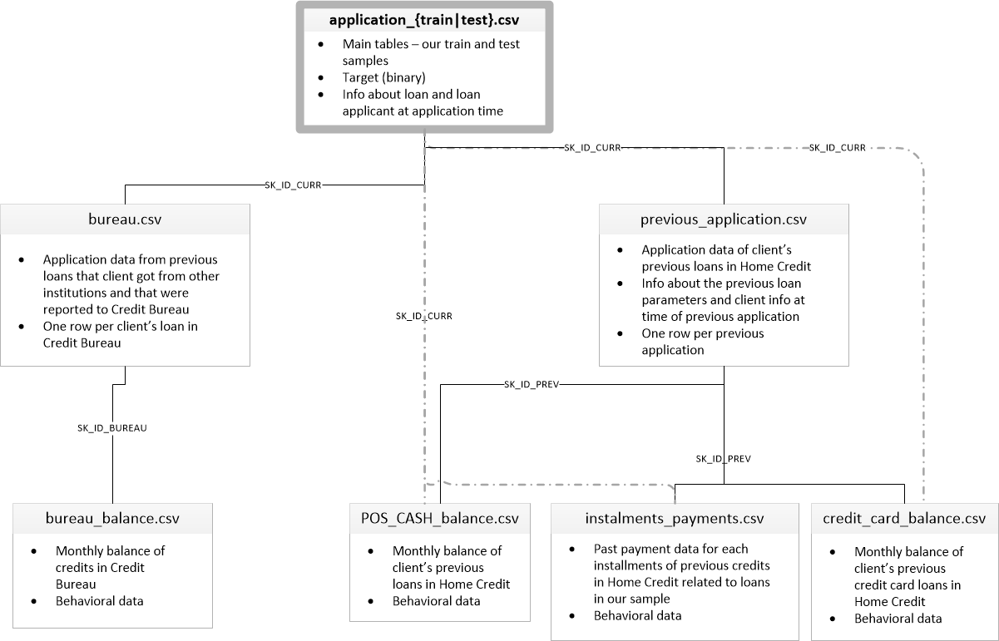

#### Bureau

**Bureau balance → bureau** \
As per data relationships chart above, I'm going to aggregate bureau balance data into bureau data.

*Bureau balance:* Monthly balance of credits in Credit Bureau. Behavioral data. \
*Bureau:* Application data from previous loans that client got from other institutions and that were reported to Credit Bureau. One row per client's loan.

In [29]:
# Preview bureau balance dataset
bureau_balance_df.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


Status of Credit Bureau loan during the month. These are categorical values so I'm going to One Hot Encode.

In [47]:
# Preview unique categorical values 
bureau_balance_df["STATUS"].value_counts()

C    13646993
0     7499507
X     5810482
1      242347
5       62406
2       23419
3        8924
4        5847
Name: STATUS, dtype: int64

In [31]:
# One Hot Encode bureau balance 
bureau_bal_ohe = pd.get_dummies(bureau_balance_df)
bureau_bal_ohe.head()

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS_0,STATUS_1,STATUS_2,STATUS_3,STATUS_4,STATUS_5,STATUS_C,STATUS_X
0,5715448,0,0,0,0,0,0,0,1,0
1,5715448,-1,0,0,0,0,0,0,1,0
2,5715448,-2,0,0,0,0,0,0,1,0
3,5715448,-3,0,0,0,0,0,0,1,0
4,5715448,-4,0,0,0,0,0,0,1,0


In [32]:
# Preview bureau dataset
bureau_df.head()

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.00,-153.00,NaN,0,91323.00,0.00,NaN,0.00,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.00,NaN,NaN,0,225000.00,171342.00,NaN,0.00,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.00,NaN,NaN,0,464323.50,NaN,NaN,0.00,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.00,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.00,NaN,77674.50,0,2700000.00,NaN,NaN,0.00,Consumer credit,-21,NaN


There are three columns with categorical values.

In [33]:
bureau_df["CREDIT_ACTIVE"].value_counts()

Closed      1079273
Active       630607
Sold           6527
Bad debt         21
Name: CREDIT_ACTIVE, dtype: int64

In [34]:
bureau_df["CREDIT_TYPE"].value_counts()

Consumer credit                                 1251615
Credit card                                      402195
Car loan                                          27690
Mortgage                                          18391
Microloan                                         12413
Loan for business development                      1975
Another type of loan                               1017
Unknown type of loan                                555
Loan for working capital replenishment              469
Cash loan (non-earmarked)                            56
Real estate loan                                     27
Loan for the purchase of equipment                   19
Loan for purchase of shares (margin lending)          4
Mobile operator loan                                  1
Interbank credit                                      1
Name: CREDIT_TYPE, dtype: int64

In [46]:
bureau_df["CREDIT_CURRENCY"].value_counts()

currency 1    1715020
currency 2       1224
currency 3        174
currency 4         10
Name: CREDIT_CURRENCY, dtype: int64

In [38]:
bureau_ohe = pd.get_dummies(bureau_df)
bureau_ohe.head()

,SK_ID_CURR,SK_ID_BUREAU,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,DAYS_CREDIT_UPDATE,AMT_ANNUITY,CREDIT_ACTIVE_Active,CREDIT_ACTIVE_Bad debt,CREDIT_ACTIVE_Closed,CREDIT_ACTIVE_Sold,CREDIT_CURRENCY_currency 1,CREDIT_CURRENCY_currency 2,CREDIT_CURRENCY_currency 3,CREDIT_CURRENCY_currency 4,CREDIT_TYPE_Another type of loan,CREDIT_TYPE_Car loan,CREDIT_TYPE_Cash loan (non-earmarked),CREDIT_TYPE_Consumer credit,CREDIT_TYPE_Credit card,CREDIT_TYPE_Interbank credit,CREDIT_TYPE_Loan for business development,CREDIT_TYPE_Loan for purchase of shares (margin lending),CREDIT_TYPE_Loan for the purchase of equipment,CREDIT_TYPE_Loan for working capital replenishment,CREDIT_TYPE_Microloan,CREDIT_TYPE_Mobile operator loan,CREDIT_TYPE_Mortgage,CREDIT_TYPE_Real estate loan,CREDIT_TYPE_Unknown type of loan
0,215354,5714462,-497,0,-153.00,-153.00,NaN,0,91323.00,0.00,NaN,0.00,-131,NaN,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,215354,5714463,-208,0,1075.00,NaN,NaN,0,225000.00,171342.00,NaN,0.00,-20,NaN,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
2,215354,5714464,-203,0,528.00,NaN,NaN,0,464323.50,NaN,NaN,0.00,-16,NaN,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
3,215354,5714465,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.00,-16,NaN,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
4,215354,5714466,-629,0,1197.00,NaN,77674.50,0,2700000.00,NaN,NaN,0.00,-21,NaN,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0


Merge Bureau_balance into Bureau

In [65]:
bureau_final = bureau_ohe.copy()
columns_to_merge = bureau_bal_ohe.drop("SK_ID_BUREAU", axis=1).columns

for col in columns_to_merge:
  result = bureau_bal_ohe.groupby("SK_ID_BUREAU")[col].mean()
  bureau_final["BALANCE_" + str(col)] = bureau_final["SK_ID_BUREAU"] \
    .map(lambda x: result[x] if x in result.index else np.nan)

In [66]:
bureau_final.info(null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 46 columns):
 #   Column                                                    Non-Null Count    Dtype  
---  ------                                                    --------------    -----  
 0   SK_ID_CURR                                                1716428 non-null  int64  
 1   SK_ID_BUREAU                                              1716428 non-null  int64  
 2   DAYS_CREDIT                                               1716428 non-null  int64  
 3   CREDIT_DAY_OVERDUE                                        1716428 non-null  int64  
 4   DAYS_CREDIT_ENDDATE                                       1610875 non-null  float64
 5   DAYS_ENDDATE_FACT                                         1082775 non-null  float64
 6   AMT_CREDIT_MAX_OVERDUE                                    591940 non-null   float64
 7   CNT_CREDIT_PROLONG                                        1716428 non-null  int64

#### Previous application

**Installments payments → previous application** \
**Credit card balance → previous application** \
**POS cash balance → previous application** \

As per data relationships chart above, I'm going to aggregate the three datasets into previous application data.

*Installments payments* - Past payment data for each installments of previous credits in Home Credit related to loans in our sample. Behavioural data. \
*Credit card balance* - Monthly balance of client's previous credit card loans in Home Credit. Behavioural data. \
*POS cash balance* - Monthly balance of client's previous loans in Home Credit. Behavioural data.

In [ ]:
# Preview installments payments data
installments_payments_df.head() 

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.00,6,-1180.00,-1187.00,6948.36,6948.36
1,1330831,151639,0.00,34,-2156.00,-2156.00,1716.53,1716.53
2,2085231,193053,2.00,1,-63.00,-63.00,25425.00,25425.00
3,2452527,199697,1.00,3,-2418.00,-2426.00,24350.13,24350.13
4,2714724,167756,1.00,2,-1383.00,-1366.00,2165.04,2160.59


All installments_payments columns are numerical, no need to one hot encode anything here.

In [ ]:
# Preview credit card balance data
cc_balance_df.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.97,135000,0.00,877.50,0.00,877.50,1700.33,1800.00,1800.00,0.00,0.00,0.00,0.00,1,0.00,1.00,35.00,Active,0,0
1,2582071,363914,-1,63975.56,45000,2250.00,2250.00,0.00,0.00,2250.00,2250.00,2250.00,60175.08,64875.56,64875.56,1.00,1,0.00,0.00,69.00,Active,0,0
2,1740877,371185,-7,31815.22,450000,0.00,0.00,0.00,0.00,2250.00,2250.00,2250.00,26926.42,31460.08,31460.08,0.00,0,0.00,0.00,30.00,Active,0,0
3,1389973,337855,-4,236572.11,225000,2250.00,2250.00,0.00,0.00,11795.76,11925.00,11925.00,224949.29,233048.97,233048.97,1.00,1,0.00,0.00,10.00,Active,0,0
4,1891521,126868,-1,453919.46,450000,0.00,11547.00,0.00,11547.00,22924.89,27000.00,27000.00,443044.40,453919.46,453919.46,0.00,1,0.00,1.00,101.00,Active,0,0


In [48]:
# One Hot Encode credit card balance data
cc_bal_ohe = pd.get_dummies(cc_balance_df)
cc_bal_ohe.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,SK_DPD,SK_DPD_DEF,NAME_CONTRACT_STATUS_Active,NAME_CONTRACT_STATUS_Approved,NAME_CONTRACT_STATUS_Completed,NAME_CONTRACT_STATUS_Demand,NAME_CONTRACT_STATUS_Refused,NAME_CONTRACT_STATUS_Sent proposal,NAME_CONTRACT_STATUS_Signed
0,2562384,378907,-6,56.97,135000,0.00,877.50,0.00,877.50,1700.33,1800.00,1800.00,0.00,0.00,0.00,0.00,1,0.00,1.00,35.00,0,0,1,0,0,0,0,0,0
1,2582071,363914,-1,63975.56,45000,2250.00,2250.00,0.00,0.00,2250.00,2250.00,2250.00,60175.08,64875.56,64875.56,1.00,1,0.00,0.00,69.00,0,0,1,0,0,0,0,0,0
2,1740877,371185,-7,31815.22,450000,0.00,0.00,0.00,0.00,2250.00,2250.00,2250.00,26926.42,31460.08,31460.08,0.00,0,0.00,0.00,30.00,0,0,1,0,0,0,0,0,0
3,1389973,337855,-4,236572.11,225000,2250.00,2250.00,0.00,0.00,11795.76,11925.00,11925.00,224949.29,233048.97,233048.97,1.00,1,0.00,0.00,10.00,0,0,1,0,0,0,0,0,0
4,1891521,126868,-1,453919.46,450000,0.00,11547.00,0.00,11547.00,22924.89,27000.00,27000.00,443044.40,453919.46,453919.46,0.00,1,0.00,1.00,101.00,0,0,1,0,0,0,0,0,0


In [ ]:
# Preview
pos_cash_balance_df.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.00,45.00,Active,0,0
1,1715348,367990,-33,36.00,35.00,Active,0,0
2,1784872,397406,-32,12.00,9.00,Active,0,0
3,1903291,269225,-35,48.00,42.00,Active,0,0
4,2341044,334279,-35,36.00,35.00,Active,0,0


In [49]:
# One Hot Encode POS_cash_balance
pos_cash_bal_ohe = pd.get_dummies(pos_cash_balance_df)
pos_cash_bal_ohe.head()

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,SK_DPD,SK_DPD_DEF,NAME_CONTRACT_STATUS_Active,NAME_CONTRACT_STATUS_Amortized debt,NAME_CONTRACT_STATUS_Approved,NAME_CONTRACT_STATUS_Canceled,NAME_CONTRACT_STATUS_Completed,NAME_CONTRACT_STATUS_Demand,NAME_CONTRACT_STATUS_Returned to the store,NAME_CONTRACT_STATUS_Signed,NAME_CONTRACT_STATUS_XNA
0,1803195,182943,-31,48.00,45.00,0,0,1,0,0,0,0,0,0,0,0
1,1715348,367990,-33,36.00,35.00,0,0,1,0,0,0,0,0,0,0,0
2,1784872,397406,-32,12.00,9.00,0,0,1,0,0,0,0,0,0,0,0
3,1903291,269225,-35,48.00,42.00,0,0,1,0,0,0,0,0,0,0,0
4,2341044,334279,-35,36.00,35.00,0,0,1,0,0,0,0,0,0,0,0


In [ ]:
# Preview previous applications dataset
previous_app_df.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.43,17145.00,17145.00,0.00,17145.00,SATURDAY,15,Y,1,0.00,0.18,0.87,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.00,middle,POS mobile with interest,365243.00,-42.00,300.00,-42.00,-37.00,0.00
1,2802425,108129,Cash loans,25188.62,607500.00,679671.00,NaN,607500.00,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.00,low_action,Cash X-Sell: low,365243.00,-134.00,916.00,365243.00,365243.00,1.00
2,2523466,122040,Cash loans,15060.74,112500.00,136444.50,NaN,112500.00,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,high,Cash X-Sell: high,365243.00,-271.00,59.00,365243.00,365243.00,1.00
3,2819243,176158,Cash loans,47041.33,450000.00,470790.00,NaN,450000.00,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.00,middle,Cash X-Sell: middle,365243.00,-482.00,-152.00,-182.00,-177.00,1.00
4,1784265,202054,Cash loans,31924.40,337500.00,404055.00,NaN,337500.00,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.00,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [51]:
# One hot encode previous applications dataset
previous_app_ohe = pd.get_dummies(previous_app_df)
previous_app_ohe.head()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Consumer loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_CONTRACT_TYPE_XNA,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,FLAG_LAST_APPL_PER_CONTRACT_N,FLAG_LAST_APPL_PER_CONTRACT_Y,NAME_CASH_LOAN_PURPOSE_Building a house or an annex,NAME_CASH_LOAN_PURPOSE_Business development,NAME_CASH_LOAN_PURPOSE_Buying a garage,NAME_CASH_LOAN_PURPOSE_Buying a holiday home / land,NAME_CASH_LOAN_PURPOSE_Buying a home,NAME_CASH_LOAN_PURPOSE_Buying a new car,NAME_CASH_LOAN_PURPOSE_Buying a used car,NAME_CASH_LOAN_PURPOSE_Car repairs,NAME_CASH_LOAN_PURPOSE_Education,NAME_CASH_LOAN_PURPOSE_Everyday expenses,NAME_CASH_LOAN_PURPOSE_Furniture,NAME_CASH_LOAN_PURPOSE_Gasification / water supply,NAME_CASH_LOAN_PURPOSE_Hobby,NAME_CASH_LOAN_PURPOSE_Journey,NAME_CASH_LOAN_PURPOSE_Medicine,NAME_CASH_LOAN_PURPOSE_Money for a third person,NAME_CASH_LOAN_PURPOSE_Other,NAME_CASH_LOAN_PURPOSE_Payments on other loans,NAME_CASH_LOAN_PURPOSE_Purchase of electronic equipment,NAME_CASH_LOAN_PURPOSE_Refusal to name the goal,NAME_CASH_LOAN_PURPOSE_Repairs,NAME_CASH_LOAN_PURPOSE_Urgent needs,NAME_CASH_LOAN_PURPOSE_Wedding / gift / holiday,NAME_CASH_LOAN_PURPOSE_XAP,NAME_CASH_LOAN_PURPOSE_XNA,NAME_CONTRACT_STATUS_Approved,NAME_CONTRACT_STATUS_Canceled,NAME_CONTRACT_STATUS_Refused,NAME_CONTRACT_STATUS_Unused offer,NAME_PAYMENT_TYPE_Cash through the bank,NAME_PAYMENT_TYPE_Cashless from the account of the employer,NAME_PAYMENT_TYPE_Non-cash from your account,NAME_PAYMENT_TYPE_XNA,CODE_REJECT_REASON_CLIENT,CODE_REJECT_REASON_HC,CODE_REJECT_REASON_LIMIT,CODE_REJECT_REASON_SCO,CODE_REJECT_REASON_SCOFR,CODE_REJECT_REASON_SYSTEM,CODE_REJECT_REASON_VERIF,CODE_REJECT_REASON_XAP,CODE_REJECT_REASON_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_CLIENT_TYPE_New,NAME_CLIENT_TYPE_Refreshed,NAME_CLIENT_TYPE_Repeater,NAME_CLIENT_TYPE_XNA,NAME_GOODS_CATEGORY_Additional Service,NAME_GOODS_CATEGORY_Animals,NAME_GOODS_CATEGORY_Audio/Video,NAME_GOODS_CATEGORY_Auto Accessories,NAME_GOODS_CATEGORY_Clothing and Accessories,NAME_GOODS_CATEGORY_Computers,NAME_GOODS_CATEGORY_Construction Materials,NAME_GOODS_CATEGORY_Consumer Electronics,NAME_GOODS_CATEGORY_Direct Sales,NAME_GOODS_CATEGORY_Education,NAME_GOODS_CATEGORY_Fitness,NAME_GOODS_CATEGORY_Furniture,NAME_GOODS_CATEGORY_Gardening,NAME_GOODS_CATEGORY_Homewares,NAME_GOODS_CATEGORY_House Construction,NAME_GOODS_CATEGORY_Insurance,NAME_GOODS_CATEGORY_Jewelry,NAME_GOODS_CATEGORY_Medical Supplies,NAME_GOODS_CATEGORY_Medicine,NAME_GOODS_CATEGORY_Mobile,NAME_GOODS_CATEGORY_Office Appliances,NAME_GOODS_CATEGORY_Other,NAME_GOODS_CATEGORY_Photo / Cinema Equipment,NAME_GOODS_CATEGORY_Sport and Leisure,NAME_GOODS_CATEGORY_Tourism,NAME_GOODS_CATEGORY_Vehicles,NAME_GOODS_CATEGORY_Weapon,NAME_GOODS_CATEGORY_XNA,NAME_PORTFOLIO_Cards,NAME_PORTFOLIO_Cars,NAME_PORTFOLIO_Cash,NAME_PORTFOLIO_POS,NAME_PORTFOLIO_XNA,NAME_PRODUCT_TYPE_XNA,NAME_PRODUCT_TYPE_walk-in,NAME_PRODUCT_TYPE_x-sell,CHANNEL_TYPE_AP+ (Cash loan),CHANNEL_TYPE_Car dealer,CHANNEL_TYPE_Channel of corporate sales,CHANNEL_TYPE_Contact center,CHANNEL_TYPE_Country-wide,CHANNEL_TYPE_Credit and cash offices,CHANNEL_TYPE_Regional / Local,CHANNEL_TYPE_Stone,NAME_SELLER_INDUSTRY_Auto technology,NAME_SELLER_INDUSTRY_Clothing,NAME_SELLER_INDUSTRY_Connectiv

In [53]:
previous_applications_final = previous_app_ohe.copy()

In [56]:
# Aggregate installments payments into previous applications dataset
columns_to_merge = installments_payments_df.drop(["SK_ID_PREV", "SK_ID_CURR"], axis=1).columns

for col in columns_to_merge:
  result = installments_payments_df.groupby("SK_ID_PREV")[col].mean()
  previous_applications_final["IP_" + str(col)] = previous_applications_final["SK_ID_PREV"] \
    .map(lambda x: result[x] if x in result.index else np.nan)

In [58]:
# Aggregate credit card balance into previous applications dataset
columns_to_merge = cc_bal_ohe.drop(["SK_ID_PREV", "SK_ID_CURR"], axis=1).columns

for col in columns_to_merge:
  result = cc_bal_ohe.groupby("SK_ID_PREV")[col].mean()
  previous_applications_final["CC_" + str(col)] = previous_applications_final["SK_ID_PREV"] \
    .map(lambda x: result[x] if x in result.index else np.nan)

In [60]:
# Aggregate POS cash balance into previous applications dataset
columns_to_merge = pos_cash_bal_ohe.drop(["SK_ID_PREV", "SK_ID_CURR"], axis=1).columns

for col in columns_to_merge:
  result = pos_cash_bal_ohe.groupby("SK_ID_PREV")[col].mean()
  previous_applications_final["POS_" + str(col)] = previous_applications_final["SK_ID_PREV"] \
    .map(lambda x: result[x] if x in result.index else np.nan)

In [61]:
previous_applications_final.head()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Consumer loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_CONTRACT_TYPE_XNA,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,FLAG_LAST_APPL_PER_CONTRACT_N,FLAG_LAST_APPL_PER_CONTRACT_Y,NAME_CASH_LOAN_PURPOSE_Building a house or an annex,NAME_CASH_LOAN_PURPOSE_Business development,NAME_CASH_LOAN_PURPOSE_Buying a garage,NAME_CASH_LOAN_PURPOSE_Buying a holiday home / land,NAME_CASH_LOAN_PURPOSE_Buying a home,NAME_CASH_LOAN_PURPOSE_Buying a new car,NAME_CASH_LOAN_PURPOSE_Buying a used car,NAME_CASH_LOAN_PURPOSE_Car repairs,NAME_CASH_LOAN_PURPOSE_Education,NAME_CASH_LOAN_PURPOSE_Everyday expenses,NAME_CASH_LOAN_PURPOSE_Furniture,NAME_CASH_LOAN_PURPOSE_Gasification / water supply,NAME_CASH_LOAN_PURPOSE_Hobby,NAME_CASH_LOAN_PURPOSE_Journey,NAME_CASH_LOAN_PURPOSE_Medicine,NAME_CASH_LOAN_PURPOSE_Money for a third person,NAME_CASH_LOAN_PURPOSE_Other,NAME_CASH_LOAN_PURPOSE_Payments on other loans,NAME_CASH_LOAN_PURPOSE_Purchase of electronic equipment,NAME_CASH_LOAN_PURPOSE_Refusal to name the goal,NAME_CASH_LOAN_PURPOSE_Repairs,NAME_CASH_LOAN_PURPOSE_Urgent needs,NAME_CASH_LOAN_PURPOSE_Wedding / gift / holiday,NAME_CASH_LOAN_PURPOSE_XAP,NAME_CASH_LOAN_PURPOSE_XNA,NAME_CONTRACT_STATUS_Approved,NAME_CONTRACT_STATUS_Canceled,NAME_CONTRACT_STATUS_Refused,NAME_CONTRACT_STATUS_Unused offer,NAME_PAYMENT_TYPE_Cash through the bank,NAME_PAYMENT_TYPE_Cashless from the account of the employer,NAME_PAYMENT_TYPE_Non-cash from your account,NAME_PAYMENT_TYPE_XNA,CODE_REJECT_REASON_CLIENT,CODE_REJECT_REASON_HC,CODE_REJECT_REASON_LIMIT,CODE_REJECT_REASON_SCO,CODE_REJECT_REASON_SCOFR,CODE_REJECT_REASON_SYSTEM,CODE_REJECT_REASON_VERIF,CODE_REJECT_REASON_XAP,CODE_REJECT_REASON_XNA,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_CLIENT_TYPE_New,NAME_CLIENT_TYPE_Refreshed,NAME_CLIENT_TYPE_Repeater,NAME_CLIENT_TYPE_XNA,NAME_GOODS_CATEGORY_Additional Service,NAME_GOODS_CATEGORY_Animals,NAME_GOODS_CATEGORY_Audio/Video,NAME_GOODS_CATEGORY_Auto Accessories,NAME_GOODS_CATEGORY_Clothing and Accessories,NAME_GOODS_CATEGORY_Computers,NAME_GOODS_CATEGORY_Construction Materials,NAME_GOODS_CATEGORY_Consumer Electronics,NAME_GOODS_CATEGORY_Direct Sales,NAME_GOODS_CATEGORY_Education,NAME_GOODS_CATEGORY_Fitness,NAME_GOODS_CATEGORY_Furniture,NAME_GOODS_CATEGORY_Gardening,NAME_GOODS_CATEGORY_Homewares,NAME_GOODS_CATEGORY_House Construction,NAME_GOODS_CATEGORY_Insurance,NAME_GOODS_CATEGORY_Jewelry,NAME_GOODS_CATEGORY_Medical Supplies,NAME_GOODS_CATEGORY_Medicine,NAME_GOODS_CATEGORY_Mobile,NAME_GOODS_CATEGORY_Office Appliances,NAME_GOODS_CATEGORY_Other,NAME_GOODS_CATEGORY_Photo / Cinema Equipment,NAME_GOODS_CATEGORY_Sport and Leisure,NAME_GOODS_CATEGORY_Tourism,NAME_GOODS_CATEGORY_Vehicles,NAME_GOODS_CATEGORY_Weapon,NAME_GOODS_CATEGORY_XNA,NAME_PORTFOLIO_Cards,NAME_PORTFOLIO_Cars,NAME_PORTFOLIO_Cash,NAME_PORTFOLIO_POS,NAME_PORTFOLIO_XNA,NAME_PRODUCT_TYPE_XNA,NAME_PRODUCT_TYPE_walk-in,NAME_PRODUCT_TYPE_x-sell,CHANNEL_TYPE_AP+ (Cash loan),CHANNEL_TYPE_Car dealer,CHANNEL_TYPE_Channel of corporate sales,CHANNEL_TYPE_Contact center,CHANNEL_TYPE_Country-wide,CHANNEL_TYPE_Credit and cash offices,CHANNEL_TYPE_Regional / Local,CHANNEL_TYPE_Stone,NAME_SELLER_INDUSTRY_Auto technology,NAME_SELLER_INDUSTRY_Clothing,NAME_SELLER_INDUSTRY_Connectiv

In [63]:
previous_applications_final.shape

(1670214, 211)

In [64]:
previous_applications_final.info(null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Columns: 211 entries, SK_ID_PREV to POS_NAME_CONTRACT_STATUS_XNA
dtypes: float64(62), int64(6), uint8(143)
memory usage: 1.1 GB


#### Application train / test

In [67]:
app_train_full = app_train_df.copy()
app_test_full = app_test_df.copy()

In [69]:
%%time
# Aggregate bureau data into app train dataset
columns_to_merge = bureau_final.drop(["SK_ID_CURR", "SK_ID_BUREAU"], axis=1).columns

for col in columns_to_merge:
  result = bureau_final.groupby("SK_ID_CURR")[col].mean()
  app_train_full["BUREAU_" + str(col)] = bureau_final["SK_ID_CURR"] \
    .map(lambda x: result[x] if x in result.index else np.nan)
  app_test_full["BUREAU_" + str(col)] = bureau_final["SK_ID_CURR"] \
    .map(lambda x: result[x] if x in result.index else np.nan)

CPU times: user 7min 40s, sys: 1.53 s, total: 7min 42s
Wall time: 7min 42s


In [72]:
app_train_full.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,BUREAU_DAYS_CREDIT,BUREAU_CREDIT_DAY_OVERDUE,BUREAU_DAYS_CREDIT_ENDDATE,BUREAU_DAYS_ENDDATE_FACT,BUREAU_AMT_CREDIT_MAX_OVERDUE,BUREAU_CNT_CREDIT_PROLONG,BUREAU_AMT_CREDIT_SUM,BUREAU_AMT_CREDIT_SUM_DEBT,BUREAU_AMT_CREDIT_SUM_LIMIT,BUREAU_AMT_CREDIT_SUM_OVERDUE,BUREAU_DAYS_CREDIT_UPDATE,BUREAU_AMT_ANNUITY,BUREAU_CREDIT_ACTIVE_Active,BUREAU_CREDIT_ACTIVE_Bad debt,BUREAU_CREDIT_ACTIVE_Closed,BUREAU_CREDIT_ACTIVE_Sold,BUREAU_CREDIT_CURRENCY_currency 1,BUREAU_CREDIT_CURRENCY_currency 2,BUREAU_CREDIT_CURRENCY_currency 3,BUREAU_CREDIT_CURRENCY_currency 4,BUREAU_CREDIT_TYPE_Another type of loan,BUREAU_CREDIT_TYPE_Car loan,BUREAU_CREDIT_TYPE_Cash loan (non-earmarked),BUREAU_CREDIT_TYPE_Consumer credit,BUREAU_CREDIT_TYPE_Credit card,BUREAU_CREDIT_TYPE_Interbank credit,BUREAU_CREDIT_TYPE_Loan for business development,BUREAU_CREDIT_TYPE_Loan for purchase of shares (margin lending),BUREAU_CREDIT_TYPE_Loan for the purchase of equipment,BUREAU_CREDIT_TYPE_Loan for working capital replenishment,BUREAU_CREDIT_TYPE_Microloan,BUREAU_CREDIT_TYPE_Mobile operator loan,BUREAU_CREDIT_TYPE_Mortgage,BUREAU_CREDIT_TYPE_Real estate loan,BUREAU_CREDIT_TYPE_Unknown type of loan,BUREAU_BALANCE_MONTHS_BALANCE,BUREAU_BALANCE_STATUS_0,BUREAU_BALANCE_STATUS_1,BUREAU_BALANCE_STATUS_2,BUREAU_BALANCE_STATUS_3,BUREAU_BALANCE_STATUS_4,BUREAU_BALANCE_STATUS_5,BUREAU_BALANCE_STATUS_C,BUREAU_BALANCE_STATUS_X
0,100002,1,Cash loans,M,N,Y,0,202500.00,406597.50,24700.50,351000.00,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.02,-9461,-637,-3648.00,-2120,NaN,1,1,0,1,1,0,Laborers,1.00,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.08,0.26,0.14,0.02,0.04,0.97,0.62,0.01,0.00,0.07,0.08,0.12,0.04,0.02,0.02,0.00,0.00,0.03,0.04,0.97,0.63,0.01,0.00,0.07,0.08,0.12,0.04,0.

In [74]:
%%time
# Aggregate previous application data into app train dataset
columns_to_merge = previous_applications_final.drop(["SK_ID_CURR", "SK_ID_PREV"], axis=1).columns

for col in columns_to_merge:
  result = previous_applications_final.groupby("SK_ID_CURR")[col].mean()
  app_train_full["PREV_APP_" + str(col)] = previous_applications_final["SK_ID_CURR"] \
    .map(lambda x: result[x] if x in result.index else np.nan)
  app_test_full["PREV_APP_" + str(col)] = previous_applications_final["SK_ID_CURR"] \
    .map(lambda x: result[x] if x in result.index else np.nan)

CPU times: user 36min 31s, sys: 4.53 s, total: 36min 36s
Wall time: 36min 36s


In [75]:
app_train_full.shape, app_test_full.shape

((307511, 375), (48744, 374))

In [76]:
app_train_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 375 entries, SK_ID_CURR to PREV_APP_POS_NAME_CONTRACT_STATUS_XNA
dtypes: float64(318), int64(41), object(16)
memory usage: 879.8+ MB


##Preprocessing

Aggregating dataframes 
https://www.kaggle.com/aantonova/aggregating-all-tables-in-one-dataset
- Compare the columns in train / test datasets and extract the features that don't exist in the test dataset.
- Check data descriptors and impute missing values 
- Drop features with small variance https://community.dataquest.io/t/feature-selection-features-with-low-variance/2418/2

### Dealing with missing values

In [114]:
get_missing_values(app_test_full)

,counts,percent
PREV_APP_RATE_INTEREST_PRIVILEGED,47877,98.22
PREV_APP_RATE_INTEREST_PRIMARY,47877,98.22
PREV_APP_CC_AMT_PAYMENT_CURRENT,36422,74.72
PREV_APP_CC_CNT_DRAWINGS_POS_CURRENT,36418,74.71
PREV_APP_CC_CNT_DRAWINGS_OTHER_CURRENT,36418,74.71
PREV_APP_CC_AMT_DRAWINGS_OTHER_CURRENT,36418,74.71
PREV_APP_CC_AMT_DRAWINGS_ATM_CURRENT,36418,74.71
PREV_APP_CC_AMT_DRAWINGS_POS_CURRENT,36418,74.71
PREV_APP_CC_CNT_DRAWINGS_ATM_CURRENT,36418,74.71
COMMONAREA_MEDI,33495,68.72


In [112]:
app_train_full.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,BUREAU_DAYS_CREDIT,BUREAU_CREDIT_DAY_OVERDUE,BUREAU_DAYS_CREDIT_ENDDATE,BUREAU_DAYS_ENDDATE_FACT,BUREAU_AMT_CREDIT_MAX_OVERDUE,BUREAU_CNT_CREDIT_PROLONG,BUREAU_AMT_CREDIT_SUM,BUREAU_AMT_CREDIT_SUM_DEBT,BUREAU_AMT_CREDIT_SUM_LIMIT,BUREAU_AMT_CREDIT_SUM_OVERDUE,BUREAU_DAYS_CREDIT_UPDATE,BUREAU_AMT_ANNUITY,BUREAU_CREDIT_ACTIVE_Active,BUREAU_CREDIT_ACTIVE_Bad debt,BUREAU_CREDIT_ACTIVE_Closed,BUREAU_CREDIT_ACTIVE_Sold,BUREAU_CREDIT_CURRENCY_currency 1,BUREAU_CREDIT_CURRENCY_currency 2,BUREAU_CREDIT_CURRENCY_currency 3,BUREAU_CREDIT_CURRENCY_currency 4,BUREAU_CREDIT_TYPE_Another type of loan,BUREAU_CREDIT_TYPE_Car loan,BUREAU_CREDIT_TYPE_Cash loan (non-earmarked),BUREAU_CREDIT_TYPE_Consumer credit,BUREAU_CREDIT_TYPE_Credit card,BUREAU_CREDIT_TYPE_Interbank credit,BUREAU_CREDIT_TYPE_Loan for business development,BUREAU_CREDIT_TYPE_Loan for purchase of shares (margin lending),BUREAU_CREDIT_TYPE_Loan for the purchase of equipment,BUREAU_CREDIT_TYPE_Loan for working capital replenishment,BUREAU_CREDIT_TYPE_Microloan,BUREAU_CREDIT_TYPE_Mobile operator loan,BUREAU_CREDIT_TYPE_Mortgage,BUREAU_CREDIT_TYPE_Real estate loan,BUREAU_CREDIT_TYPE_Unknown type of loan,BUREAU_BALANCE_MONTHS_BALANCE,BUREAU_BALANCE_STATUS_0,BUREAU_BALANCE_STATUS_1,BUREAU_BALANCE_STATUS_2,BUREAU_BALANCE_STATUS_3,BUREAU_BALANCE_STATUS_4,BUREAU_BALANCE_STATUS_5,BUREAU_BALANCE_STATUS_C,BUREAU_BALANCE_STATUS_X,PREV_APP_AMT_ANNUITY,PREV_APP_AMT_APPLICATION,PREV_APP_AMT_CREDIT,PREV_APP_AMT_DOWN_PAYMENT,PREV_APP_AMT_GOODS_PRICE,PREV_APP_HOUR_APPR_PROCESS_START,PREV_APP_NFLAG_LAST_APPL_IN_DAY,PREV_APP_RATE_DOWN_PAYMENT,PREV_APP_RATE_INTEREST_PRIMARY,PREV_APP_RATE_INTEREST_PRIVILEGED,PREV_APP_DAYS_DECISION,PREV_APP_SELLERPLACE_AREA,PREV_APP_CNT_PAYMENT,PREV_APP_DAYS_FIRST_DRAWING,PREV_APP_DAYS_FIRST_DUE,PREV_APP_DAYS_

In [78]:
x_train = app_train_full.drop("TARGET", axis=1)
y_train = app_train_full["TARGET"]
x_test = app_test_full

### One Hot Encoding

In [79]:
# Init Sklearn One Hot Encoder
ohe = OneHotEncoder(handle_unknown="ignore")

# Fit and transform the categorical columns
onehot_train_labels = ohe.fit_transform(x_train[categorical_cols]).toarray()
onehot_test_labels = ohe.transform(x_test[categorical_cols]).toarray()

# Get new column names
new_columns = list()
for col, values in zip(categorical_cols, ohe.categories_):
  new_columns.extend([col + "_" + str(value) for value in values])

# Save one hot encoded data to df
onehot_train_df = pd.DataFrame(onehot_train_labels, columns=new_columns).reset_index(drop=True)
onehot_test_df = pd.DataFrame(onehot_test_labels, columns=new_columns).reset_index(drop=True)

### Scale numerical data

In [82]:
# All numerical columns
numerical_train_df = x_train.drop(categorical_cols, axis=1).reset_index(drop=True)
numerical_test_df = x_test.drop(categorical_cols, axis=1).reset_index(drop=True)

# Init scaler
scaler = StandardScaler()

# Fit and transform the training data
scaler.fit(numerical_train_df)
scaled_train_df = pd.DataFrame(scaler.transform(numerical_train_df), columns=numerical_train_df.columns)
scaled_test_df = pd.DataFrame(scaler.transform(numerical_test_df), columns=numerical_test_df.columns)

In [83]:
# Combine encoded and scaled data
x_train_final = pd.concat([onehot_train_df, scaled_train_df], join="inner", axis=1)
x_test_final = pd.concat([onehot_test_df, scaled_test_df], join="inner", axis=1)

x_train_final.shape, x_test_final.shape

((307511, 504), (48744, 504))

## Feature engineering

Feature engineering ideas:


## Modelling

### Logistic Regression

### Random Forest Classifier 

###XGB Classifier

In [84]:
%%time
xgbc = xgb.XGBClassifier(verbosity=0, enable_categorical=True)

scores = cross_val_score(xgbc, x_train_final, y_train, cv=5, 
                         scoring="roc_auc")

print(f"ROC AUC: {scores.mean()}, std: {scores.std()}")

ROC AUC: 0.7422200348092656, std: 0.002870383489429405
CPU times: user 1h 37min 44s, sys: 52.1 s, total: 1h 38min 36s
Wall time: 7min 6s


In [86]:
%%time
xgbc_model = xgbc.fit(x_train_final, y_train)
xgbc_pred = xgbc_model.predict_proba(x_test_final)

CPU times: user 24min 9s, sys: 12 s, total: 24min 21s
Wall time: 1min 48s


In [87]:
generateSubmissionCsv(xgbc_pred[:,1], "xgbc_")

### Light GBM Classifier

In [92]:
# Fix lightgbm "Do not support special JSON characters in feature name" error
import re
x_train_final = x_train_final.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
x_test_final = x_test_final.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [93]:
%%time
lgbc = lgb.LGBMClassifier()

scores = cross_val_score(lgbc, x_train_final, y_train, cv=5, 
                         scoring="roc_auc")

print(f"ROC AUC: {scores.mean()}, std: {scores.std()}")

ROC AUC: 0.7540191419910413, std: 0.0029509175581575293
CPU times: user 7min 47s, sys: 25.2 s, total: 8min 12s
Wall time: 53 s


In [95]:
%%time
lgbc_model = lgbc.fit(x_train_final, y_train)
lgbc_pred = lgbc_model.predict_proba(x_test_final)

CPU times: user 1min 46s, sys: 5.61 s, total: 1min 52s
Wall time: 11.6 s


In [96]:
generateSubmissionCsv(lgbc_pred[:,1], "lgbc_")

## Results log
Model | Local score | Kaggle private | Kaggle public | Features | Params | Scaler | Comments
------|-------------|---------------|------------- | --------- | ------ | ------ | ----
XGBClassifier | 0.707 | 0.731 | 0.733 | numerical features, main dataset only | default params | none | no missing value imputation
XGBClassifier | 0.742 | 0.732 | 0.729 | all features, aggregated datasets | default params | StandardScaler | no missing value imputation
LGBMClassifier | 0.747 | 0.735 | 0.735 | numerical features, main dataset only | default params | none | no missing value imputation
LGBMClassifier | 0.754 | 0.740 | 0.743 | all features, aggregated datasets | default params | StandardScaler | no missing value imputation